<a href="https://colab.research.google.com/github/all-alli90/Mendeley-Diabetes-Dataset/blob/Initial-Result-and-Code/Predictive_Modeling_of_Diabetes_using_Decision_Tree%2C_K_NN_and_Logistic_Regression.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Predictive Modeling of Diabetes Using Decision Tree, K-Nearest Neighbour and Logistic Regression**

# Importing Dataset and Libraries

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

!pip install ydata-profiling
from ydata_profiling import ProfileReport

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler

from sklearn.tree import plot_tree
from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_predict
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier

from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import precision_score, accuracy_score, recall_score, f1_score

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 390.6/390.6 kB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 24.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 31.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 9.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 71.0 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=f93ec41a5b2e23721ce3ee9fc34291425b4c14c8ae4926342a24f5b6a621309e
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


In [ ]:
from google.colab import files
uploaded = files.upload()

Saving Dataset of Diabetes .csv to Dataset of Diabetes .csv


In [ ]:
db = pd.read_csv("Dataset of Diabetes .csv")
db

,ID,No_Pation,Gender,AGE,Urea,Cr,HbA1c,Chol,TG,HDL,LDL,VLDL,BMI,CLASS
0,502,17975,F,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,N
1,735,34221,M,26,4.5,62,4.9,3.7,1.4,1.1,2.1,0.6,23.0,N
2,420,47975,F,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,N
3,680,87656,F,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,N
4,504,34223,M,33,7.1,46,4.9,4.9,1.0,0.8,2.0,0.4,21.0,N
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,200,454317,M,71,11.0,97,7.0,7.5,1.7,1.2,1.8,0.6,30.0,Y
996,671,876534,M,31,3.0,60,12.3,4.1,2.2,0.7,2.4,15.4,37.2,Y
997,669,87654,M,30,7.1,81,6.7,4.1,1.1,1.2,2.4,8.1,27.4,Y
998,99,24004,M,38,5.8,59,6.7,5.3,2.0,1.6,2.9,14.0,40.5,Y


# **Stage 1: Data Preparation**

##Data Formatting

In [ ]:
#renamed columns to remove capitalization, correct spelling and have overall consistency

db.columns = ['id', 'no_patient', 'gender', 'age', 'urea', 'cr',
              'hba1c', 'chol', 'tg', 'hdl',
              'ldl', 'vldl', 'bmi', 'db_class']

db.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 14 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   id          1000 non-null   int64  
 1   no_patient  1000 non-null   int64  
 2   gender      1000 non-null   object 
 3   age         1000 non-null   int64  
 4   urea        1000 non-null   float64
 5   cr          1000 non-null   int64  
 6   hba1c       1000 non-null   float64
 7   chol        1000 non-null   float64
 8   tg          1000 non-null   float64
 9   hdl         1000 non-null   float64
 10  ldl         1000 non-null   float64
 11  vldl        1000 non-null   float64
 12  bmi         1000 non-null   float64
 13  db_class    1000 non-null   object 
dtypes: float64(8), int64(4), object(2)
memory usage: 109.5+ KB


## Data Cleaning

In [ ]:
#checking for missing values

print(db.isnull().sum())

id            0
no_patient    0
gender        0
age           0
urea          0
cr            0
hba1c         0
chol          0
tg            0
hdl           0
ldl           0
vldl          0
bmi           0
db_class      0
dtype: int64


In [ ]:
#checking for duplicate values in id column

duplicate_id = db['id'].duplicated().sum()
duplicate_id

200

In [ ]:
#identifying the duplicate id vlaues

duplicate_num_id = db['id'].value_counts()
duplicate_num_id = duplicate_num_id[duplicate_num_id > 1]
print(duplicate_num_id)

id
76     2
108    2
57     2
26     2
69     2
      ..
150    2
49     2
144    2
145    2
147    2
Name: count, Length: 200, dtype: int64


In [ ]:
#Random sample #1 - Checking if the ids are duplicate values only or duplicate patient record.
#Since the other columns have different values, this might be duplicate id values only.

display(db[db['id'] == 76])

,id,no_patient,gender,age,urea,cr,hba1c,chol,tg,hdl,ldl,vldl,bmi,db_class
249,76,9903,M,73,4.3,79,6.0,5.3,1.4,1.5,3.2,0.6,27.0,Y
910,76,8978,M,60,5.4,64,10.4,3.8,1.5,0.8,2.3,0.6,31.0,Y


In [ ]:
#Random sample #2
#Helps to confirm that these are duplicate id values rather than duplicate patient records.

display(db[db['id'] == 150])

,id,no_patient,gender,age,urea,cr,hba1c,chol,tg,hdl,ldl,vldl,bmi,db_class
88,150,45382,F,40,6.3,79,4.9,4.3,0.8,0.8,1.8,1.2,22.0,N
184,150,34287,F,42,2.8,39,4.6,4.7,2.5,1.3,2.4,1.1,25.0,Y


In [ ]:
#checking for duplicate values in patient number column

duplicate_no_patient = db['no_patient'].duplicated().sum()
duplicate_no_patient

39

In [ ]:
#identifying the duplicate patient numbers

duplicate_num_patient = db['no_patient'].value_counts()
duplicate_num_patient = duplicate_num_patient[duplicate_num_patient > 1]
print(duplicate_num_patient)

no_patient
454316    19
856        2
87654      2
71741      2
34290      2
14389      2
34517      2
48362      2
45646      2
44835      2
24033      2
34514      2
23972      2
34325      2
234        2
45370      2
34516      2
34518      2
2345       2
34515      2
34545      2
345        2
Name: count, dtype: int64


In [ ]:
#Random sample #1 - Checking if the patient number are duplicate values only or duplicate patient record.
#Since the other columns have different values, this might be duplicate values only.

display(db[db['no_patient'] == 45646])

,id,no_patient,gender,age,urea,cr,hba1c,chol,tg,hdl,ldl,vldl,bmi,db_class
936,111,45646,F,63,4.7,55,12.60,7.9,5.0,1.3,2.1,0.7,35.0,Y
938,113,45646,F,55,2.1,23,9.96,4.1,4.2,1.2,1.4,1.3,29.0,Y


In [ ]:
#Random sample #2
#Helps to confirm that these are duplicate patient number rather than duplicate patient records.

display(db[db['no_patient'] == 34290])

,id,no_patient,gender,age,urea,cr,hba1c,chol,tg,hdl,ldl,vldl,bmi,db_class
34,699,34290,F,47,5.6,67,5.1,6.5,1.5,0.9,4.9,0.7,23.0,N
260,510,34290,M,73,4.3,79,6.9,5.3,1.4,1.5,3.2,0.6,28.0,Y


In [ ]:
#checking the gender column

gender_frequency = db['gender'].value_counts()
print(gender_frequency)

gender
M    565
F    434
f      1
Name: count, dtype: int64


In [ ]:
#Converting the lowercase f to uppercase and updating the gender_frequency variable

db['gender'] = db['gender'].replace({'f': 'F'})
gender_frequency = db['gender'].value_counts()
print(gender_frequency)

gender
M    565
F    435
Name: count, dtype: int64


In [ ]:
#checking the class column

class_frequency = db['db_class'].value_counts()
print(class_frequency)

db_class
Y     840
N     102
P      53
Y       4
N       1
Name: count, dtype: int64


In [ ]:
#There is a space trailing after some of the Y and N values (eg: 'Y ' and 'N '). This is causing the data to be read as different values.
#The below converts these values to Y and N respectively

db['db_class'] = db['db_class'].replace({'N ': 'N', 'Y ': 'Y'})
class_frequency = db['db_class'].value_counts()
print(class_frequency)

db_class
Y    844
N    103
P     53
Name: count, dtype: int64


# **Stage 2: Exploratory Data Analysis**

## Statistical Summary

In [ ]:
#Statistical summary of the attributes

db.describe()

,id,no_patient,age,urea,cr,hba1c,chol,tg,hdl,ldl,vldl,bmi
count,1000.000000,1.000000e+03,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,340.500000,2.705514e+05,53.528000,5.124743,68.943000,8.281160,4.862820,2.349610,1.204750,2.609790,1.854700,29.578020
std,240.397673,3.380758e+06,8.799241,2.935165,59.984747,2.534003,1.301738,1.401176,0.660414,1.115102,3.663599,4.962388
min,1.000000,1.230000e+02,20.000000,0.500000,6.000000,0.900000,0.000000,0.300000,0.200000,0.300000,0.100000,19.000000
25%,125.750000,2.406375e+04,51.000000,3.700000,48.000000,6.500000,4.000000,1.500000,0.900000,1.800000,0.700000,26.000000
50%,300.500000,3.439550e+04,55.000000,4.600000,60.000000,8.000000,4.800000,2.000000,1.100000,2.500000,0.900000,30.000000
75%,550.250000,4.538425e+04,59.000000,5.700000,73.000000,10.200000,5.600000,2.900000,1.300000,3.300000,1.500000,33.000000
max,800.000000,7.543566e+07,79.000000,38.900000,800.000000,16.000000,10.300000,13.800000,9.900000,9.900000,35.000000,47.750000


The average age of the patients in the dataset is 53.53, suggeting the population is mostly middle age. The creatinine variable has a large standard deviation (59.98) and a large range (from 6 to 800), suggesting the presence of extreme values.

## Correlation Analysis

In [ ]:
#Using Panda Profile Report for further analysis

report = ProfileReport(db)
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Report confirms there are no missing values or duplicate rows within the dataset.


Both HbA1c and Cholesterol exhibit a normal bell shaped distribution, indicating a relatively even spread of data around the mean. The other features appear skewed, suggesting that their data distributions are more concentrated around certain values, and the presence of outliers.  

Cholesterol, triglycerides, HLDL and LDL have variances below 2, with the lowest being 0.44 for the HLDL variable. This suggests that these variables exhibit small spread with most of the values being close to the mean.

There are several correlations obsevered among the variable. Triglycerides(tg) has a high positive correlation with vldl (0.599), and creatinine has a high positive correlation with urea (0.568). BMI exhibits moderately positive correlation with a coefficient of 0.417, suggesting elevaated HbA1c levels are associated with BMI.

The target variable, db_class, has a strong positive correlation with bmi (0.549) and hba1c (0.662). This suggests that both bmi and hba1c are influential and important in determining the likelihood of diabetes.


There is a significant class imbalance with 844 individuals classified as diabetic, 103 as non-diabetic, and only 53 as pre-diabetic. This 51.5% imbalance may affect the performance of the predictive algorithms leading to bias towards the majority class.

## Data Visualization

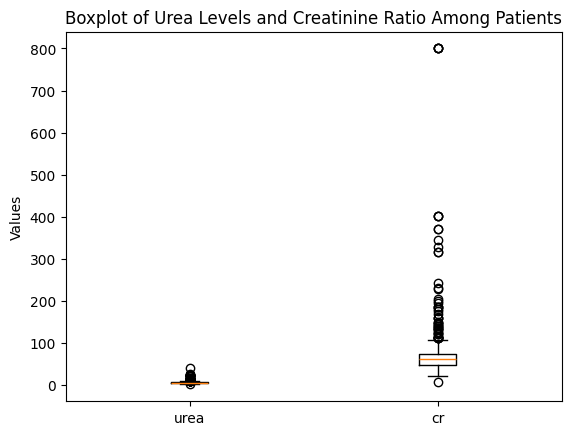

In [ ]:
#Observing distribution of values in Urea and Creatinine

plt.boxplot(db[['urea','cr']])
plt.title('Boxplot of Urea Levels and Creatinine Ratio Among Patients')

plt.xticks([1, 2], ['urea','cr'])
plt.ylabel("Values")

plt.show()

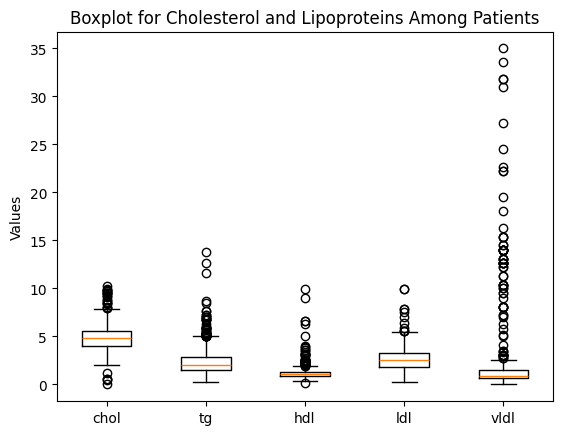

In [ ]:
#Observing distribution of values in Urea and Creatinine

plt.boxplot(db[['chol','tg','hdl','ldl','vldl']])
plt.title('Boxplot for Cholesterol and Lipoproteins Among Patients')

plt.xticks([1, 2, 3, 4, 5], ['chol','tg','hdl','ldl','vldl'])
plt.ylabel("Values")

plt.show()

There are noticeable outliers present in the cholesterol, lipoprotein, urea, and creatinine attributes. This suggests that several patients may have extreme values for these attributes.

Urea and creatinine ratio are clinical measurements used to assess kidney impairment. While cholestrol, the lipoproteins and trtriglycerides levels are used to determine cardiovascular damage. These outliers therefore suggests there may be patients with kidney and cardiovascular damage.

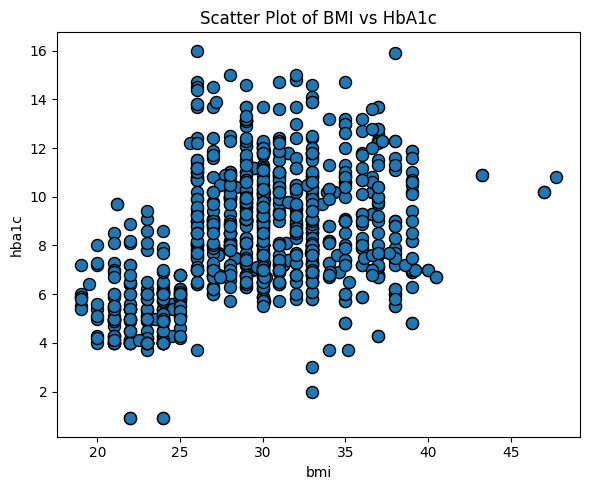

In [ ]:
#Graph showing relationship between BMI and Glusoce

plt.figure(figsize=(6, 5))
plt.scatter(db['bmi'], db['hba1c'], s=75, edgecolor='k')

plt.title('Scatter Plot of BMI vs HbA1c')
plt.xlabel('bmi')
plt.ylabel('hba1c')
plt.tight_layout()
plt.show()

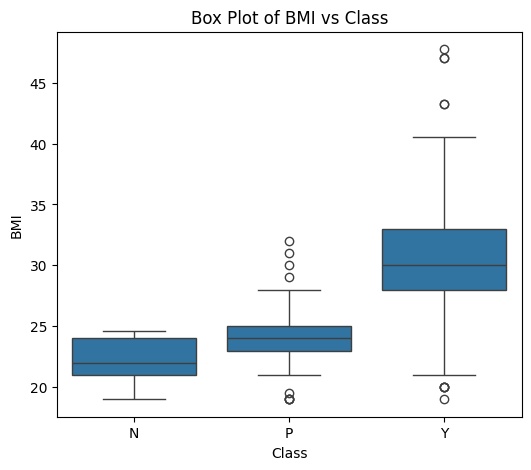

In [ ]:
#Graph showing relationship between BMI and Class

plt.figure(figsize=(6, 5))
sns.boxplot(x='db_class', y='bmi', data=db)
plt.title('Box Plot of BMI vs Class')
plt.xlabel('Class')
plt.ylabel('BMI')
plt.show()

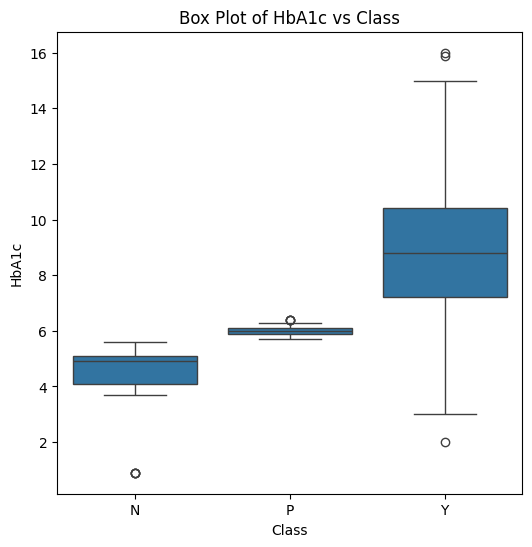

In [ ]:
#Graph showing relationship between BMI and Class

plt.figure(figsize=(6, 6))
sns.boxplot(x='db_class', y='hba1c', data=db)
plt.title('Box Plot of HbA1c vs Class')
plt.xlabel('Class')
plt.ylabel('HbA1c')
plt.show()

# **Stage 3: Data Preprocessing**

## Label Encoding

In [ ]:
#Tried to apply DecisionTreeclassifer to dataset, however got an error - ValueError: could not convert string to float: 'F'. This indicates that the DecisionTreeClassifier cannot convert the categorical value.
#Applied LabelEncoder which allows each string in the categorical variables (gender and db_class columns) to be replaced with a numerical value

db_encode=db.copy()

label_encoder = LabelEncoder()

db_encode['gender'] = label_encoder.fit_transform(db_encode['gender'])
db_encode['db_class'] = label_encoder.fit_transform(db_encode['db_class'])

db_encode.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 14 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   id          1000 non-null   int64  
 1   no_patient  1000 non-null   int64  
 2   gender      1000 non-null   int64  
 3   age         1000 non-null   int64  
 4   urea        1000 non-null   float64
 5   cr          1000 non-null   int64  
 6   hba1c       1000 non-null   float64
 7   chol        1000 non-null   float64
 8   tg          1000 non-null   float64
 9   hdl         1000 non-null   float64
 10  ldl         1000 non-null   float64
 11  vldl        1000 non-null   float64
 12  bmi         1000 non-null   float64
 13  db_class    1000 non-null   int64  
dtypes: float64(8), int64(6)
memory usage: 109.5 KB


In [ ]:
 #Compared the count with db_class count performed during cleaning to ensure consistency and understand the new format.
 #Class Attributes are now: 0 = Not diabetic (previously N) ; 1 = Prediabetic (previously P) ; 2 = Diabetic (previously Y)
 db_encode['db_class'].value_counts()

,count
db_class,
2,844
0,103
1,53


## Data Normalization

In [ ]:
#Normalizing to scale the dataset to a standard range, and reduce influence of outliers:

def normalize(x):
  return ((x - min(x)) / (max(x) - min(x)))

In [ ]:
X = list(set(list(db_encode)) - set(['db_class']))
db_norm = db_encode.iloc[:,].copy()
db_norm[X] = db_norm[X].apply(normalize)

db_norm.head(5)

,id,no_patient,gender,age,urea,cr,hba1c,chol,tg,hdl,ldl,vldl,bmi,db_class
0,0.627034,0.000237,0.0,0.508475,0.109375,0.050378,0.264901,0.407767,0.044444,0.226804,0.114583,0.011461,0.173913,0
1,0.918648,0.000452,1.0,0.101695,0.104167,0.070529,0.264901,0.359223,0.081481,0.092784,0.187500,0.014327,0.139130,0
2,0.524406,0.000634,0.0,0.508475,0.109375,0.050378,0.264901,0.407767,0.044444,0.226804,0.114583,0.011461,0.173913,0
3,0.849812,0.001160,0.0,0.508475,0.109375,0.050378,0.264901,0.407767,0.044444,0.226804,0.114583,0.011461,0.173913,0
4,0.629537,0.000452,1.0,0.220339,0.171875,0.050378,0.264901,0.475728,0.051852,0.061856,0.177083,0.008596,0.069565,0


## Data Splitting

In [ ]:
train_norm_set, test_norm_set = train_test_split(db_norm, train_size = 0.7, random_state = 89)

# Separating feature variables from the target variable
X_train = train_norm_set.drop('db_class', axis=1)
y_train = train_norm_set['db_class']

X_test = test_norm_set.drop('db_class', axis=1)
y_test = test_norm_set['db_class']

# **Stage 4: Data Modelling**

## Cross Validation of Base Models

In [ ]:
#Decided to use StratifiedKFold for cross valiation given the class imbalance within the dataset. StratifiedKFold ensures that each fold maintains the same proportion of samples for each class
#This ensure that the cross-validation process is more reliable in representing the class distribution in the original dataset, and prevents misleading results that could arise from an unbalanced distribution in the validation folds

strat_fold = StratifiedKFold(n_splits=10, random_state=10, shuffle=True)

dc_model = DecisionTreeClassifier(random_state=10)
pred_dc_val = cross_val_predict(dc_model, X_train, y_train, cv=strat_fold)

lgr_model = LogisticRegression(random_state=10, multi_class='multinomial')
pred_lgr_val = cross_val_predict(lgr_model, X_train, y_train, cv=strat_fold)

knn_model = KNeighborsClassifier(n_neighbors=5)
pred_knn_val = cross_val_predict(knn_model, X_train, y_train, cv=strat_fold)

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and wi

## Training Second Level Model

In [ ]:
# Stacking the validation predictions from each base model to form the training set for the second level model

X_seclvl_train = np.column_stack((pred_dc_val, pred_lgr_val, pred_knn_val))

In [ ]:
# Training the second level model - Logistic Regression

seclvl_model = LogisticRegression(random_state=20)
seclvl_model.fit(X_seclvl_train, y_train)

LogisticRegression(random_state=20)

## Final Prediction

In [ ]:
#Training the base models on all the training dataset to adequately make predictions on the test set

dc_model.fit(X_train, y_train)
pred_dc_test = dc_model.predict(X_test)

lgr_model.fit(X_train, y_train)
pred_lgr_test = lgr_model.predict(X_test)

knn_model.fit(X_train, y_train)
pred_knn_test = knn_model.predict(X_test)

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(


In [ ]:
# Stacking the predictions made by the base models on the test set
X_seclvl_test = np.column_stack((pred_dc_test, pred_lgr_test, pred_knn_test))

# Final prediction using the second level model
pred_final = seclvl_model.predict(X_seclvl_test)

# **Stage 5: Model Evaluation**

## Base Model Evaluation

In [ ]:
cf_dc =confusion_matrix(y_test, pred_dc_test)
print("Confusion Matrix for Decision Tree Base Model:\n")
print(cf_dc)

Confusion Matrix for Decision Tree Base Model:

[[ 27   0   1]
 [  0  16   2]
 [  0   4 250]]


In [ ]:
print("Confusion Matrix for Decision Tree Base Model:\n")
print(classification_report(y_test, pred_dc_test))
dc_accuarcy = accuracy_score(y_test, pred_dc_test)
print("Decision Tree Accuracy:", dc_accuarcy)

Confusion Matrix for Decision Tree Base Model:

              precision    recall  f1-score   support

           0       1.00      0.96      0.98        28
           1       0.80      0.89      0.84        18
           2       0.99      0.98      0.99       254

    accuracy                           0.98       300
   macro avg       0.93      0.95      0.94       300
weighted avg       0.98      0.98      0.98       300

Decision Tree Accuracy: 0.9766666666666667


In [ ]:
cf_lgr =confusion_matrix(y_test, pred_lgr_test)
print("Confusion Matrix for Logisitic Regression Base Model:\n")
print(cf_lgr)

Confusion Matrix for Logisitic Regression Base Model:

[[ 27   0   1]
 [  4   0  14]
 [  8   0 246]]


In [ ]:
print("Confusion Matrix for Logisitic Regression Base Model:\n")
print(classification_report(y_test, pred_lgr_test))
lgr_accuarcy = accuracy_score(y_test, pred_lgr_test)
print("Logisitic Regression Accuracy:", lgr_accuarcy)

Confusion Matrix for Logisitic Regression Base Model:

              precision    recall  f1-score   support

           0       0.69      0.96      0.81        28
           1       0.00      0.00      0.00        18
           2       0.94      0.97      0.96       254

    accuracy                           0.91       300
   macro avg       0.54      0.64      0.59       300
weighted avg       0.86      0.91      0.88       300

Logisitic Regression Accuracy: 0.91


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [ ]:
cf_knn =confusion_matrix(y_test, pred_knn_test)
print("Confusion Matrix for kNN Base Model:\n")
print(cf_knn)

Confusion Matrix for kNN Base Model:

[[ 24   2   2]
 [  7   6   5]
 [  6   4 244]]


In [ ]:
print("Confusion Matrix for kNN Base Model:\n")
print(classification_report(y_test, pred_knn_test))
knn_accuarcy = accuracy_score(y_test, pred_knn_test)
print("kNN Accuracy:", knn_accuarcy)

Confusion Matrix for kNN Base Model:

              precision    recall  f1-score   support

           0       0.65      0.86      0.74        28
           1       0.50      0.33      0.40        18
           2       0.97      0.96      0.97       254

    accuracy                           0.91       300
   macro avg       0.71      0.72      0.70       300
weighted avg       0.91      0.91      0.91       300

kNN Accuracy: 0.9133333333333333


## Second Level Model Evaluation

In [ ]:
cf_final =confusion_matrix(y_test, pred_final)
print("Confusion Matrix for Second Level Model:\n")
print(cf_final)

Confusion Matrix for Second Level Model:

[[ 27   0   1]
 [  4   3  11]
 [  1   0 253]]


In [ ]:
print("Second Level Model Performance Metrics:\n")
print(classification_report(y_test, pred_final))
final_accuarcy = accuracy_score(y_test, pred_final)
print("Second Level Model Accuracy:", final_accuarcy)

Second Level Model Performance Metrics:

              precision    recall  f1-score   support

           0       0.84      0.96      0.90        28
           1       1.00      0.17      0.29        18
           2       0.95      1.00      0.97       254

    accuracy                           0.94       300
   macro avg       0.93      0.71      0.72       300
weighted avg       0.95      0.94      0.93       300

Second Level Model Accuracy: 0.9433333333333334
